# UC San Diego: Data Science in Practice - EDA Checkpoint
### Summer Session I 2023 | Instructor : C. Alex Simpkins Ph.D.

## The Relationship Between Traffic Accidents and the Week of the UCSD Quarter

# Names

- Sumadhu (Genie) Rubaiyat
- John Carrion
- Girish Krishnan
- Sarah Reine Bulatao
- Seiji Yang
- Ho Lam Woo

<a id='research_question'></a>
# Research Question

**Does some ordering of the weeks in a typical UCSD quarter correlate with the number of collisions near UCSD reported to the police? Does the mile radius around UCSD influence the relationship between these variables?**

# Setup

#### Dataset Description

**Traffic collision reports recorded by the San Diego Police Department**
- Dataset Name: Traffic collisions (2015 through year-to-date)
- Link to the dataset: https://data.sandiego.gov/datasets/police-collisions/
- Number of observations: 64210

This dataset contains information about traffic collisions that were reported to the San Diego Police Department from 2015 to the present. The dataset contains information about the date, time, location, and type of collision. It also contains information about the number of injuries, and the number of fatalities. This is data that is reported to the San Diego Police, so it may not be a complete record of all traffic collisions that occurred in San Diego (as there may be collisions that were not reported to the police).

**Quarter Start/End Dates scraped from UC San Diego's Academic and Administrative Calendars**
- Dataset Name: UCSD Quarter Start and End Dates
- Link to the dataset: `./start_end_dates.json`
- Number of observations: 20

This dataset contains the start and end dates for each academic quarter, scraped from UCSD's academic and administrative calendars. Each observation contains the start and end date for Fall, Winter, and Spring quarters, in that order, and the key corresponds to the academic year. The data covers all quarters from 2003-2024, and was scraped from the URL format: `https://blink.ucsd.edu/instructors/resources/academic/calendars/[YEAR].html`.

**Plan for combining these datasets:** 
We plan to categorize each observation in the Traffic Collision Reports by Week 1-10 in their academic quarter, as well as adding columns for the quarter and year. To do this, we will apply a function to convert the datetime of each observation into its respective week, quarter, and year by checking the date_time against the `start_end_dates` database.

#### Imports

This section demonstrates how to pull all the datasets we need into Python and wrangle the data so that it is in a form that is needed for future analyses and visualization.

In [1]:
## Import Packages for Data Cleaning / Wrangling
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Import Packages for Calculations
import math
from datetime import datetime, timedelta

# Import Packages for Web Scraping
import requests
from bs4 import BeautifulSoup
import json
from dotenv import load_dotenv

# Packages for geo data and plotting
import folium

import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
%config InlineBackend.figure_format = 'retina'  # Higher resolution figures

COLLISIONS_DATASET_PATH = "collisions_data.csv"
COLLISIONS_COORDINATES_DATASET_PATH = "collisions_data_location.csv"
COLLISIONS_NEAR_UCSD_PATH = "collisions_data_ucsd.csv"

#### Fetching dataset and creating dataframe

##### Collisions Dataset

In [2]:
# Fetch collisions dataset, save it locally as well
if not os.path.exists(COLLISIONS_DATASET_PATH):
    print("Fetching collisions dataset...")
    collisions = pd.read_csv('https://seshat.datasd.org/pd/pd_collisions_datasd_v1.csv')
    collisions.to_csv(COLLISIONS_DATASET_PATH)
else:
    print("Collisions dataset already exists locally, reading from file...")
    collisions = pd.read_csv(COLLISIONS_DATASET_PATH)

collisions.head()

Collisions dataset already exists locally, reading from file...


,Unnamed: 0,report_id,date_time,police_beat,address_no_primary,address_pd_primary,address_road_primary,address_sfx_primary,address_pd_intersecting,address_name_intersecting,address_sfx_intersecting,violation_section,violation_type,charge_desc,injured,killed,hit_run_lvl
0,0,171111,2015-01-14 20:00:00,835,4200,,JUNIPER,STREET,,,,MISC-HAZ,VC,MISCELLANEOUS HAZARDOUS VIOLATIONS OF THE VEHI...,0,0,MISDEMEANOR
1,1,192016,2015-03-19 12:00:00,622,5200,,LINDA VISTA,ROAD,,,,MISC-HAZ,VC,MISCELLANEOUS HAZARDOUS VIOLATIONS OF THE VEHI...,0,0,MISDEMEANOR
2,2,190012,2015-03-24 03:05:00,626,1000,W,WASHINGTON,STREET,,,,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,2,0,NaN
3,3,191866,2015-03-27 23:56:00,613,2800,,WORDEN,STREET,,,,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,1,0,NaN
4,4,185207,2015-07-06 11:45:00,813,2800,,EL CAJON,BOULEVARD,,,,20002(A),VC,HIT AND RUN,0,0,MISDEMEANOR


##### Quarter Instruction Start and End Dates at UCSD

In [3]:
# Helper function to find the next element after a given text
def find_next_element_after_text(url, target_text):
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    elements_with_target_text = soup.find_all(text=target_text)

    # If no elements with target text are found, try again with lower case on the second word.
    if not elements_with_target_text:
        target_text = target_text.split(' ')[0] + ' ' + target_text.split(' ')[1].lower()
        elements_with_target_text = soup.find_all(text=target_text)

    results = []

    for element_text in elements_with_target_text:
        if element_text.strip() == target_text:
            next_element = element_text.find_next()
            if next_element:
                results.append(next_element.get_text().strip())

    return results

# Check if start_end_dates.json exists. If it does, load it. If not, scrape the website and create it.
if os.path.isfile('./start_end_dates.json'):
    print('start_end_dates.json already exists. Loading it...')
    start_end_dates = json.load(open('start_end_dates.json'))

else:
    print('start_end_dates.json does not exist. Scraping the website and creating it...')
    # Make a dictionary for each academic quarter, with the quarter name as the key and the start and end dates as the values.
    # years from 2003 to 2023
    years = [str(i) for i in range(2003, 2024)]
    start_end_dates = {}

    for year in years:
        url_to_scrape = 'https://blink.ucsd.edu/instructors/resources/academic/calendars/' + year + '.html'
        
        # Indexing:
        # 0: Fall Quarter
        # 1: Winter Quarter
        # 2: Spring Quarter

        # Get the start and end dates for each quarter
        fall_start = find_next_element_after_text(url_to_scrape, 'Instruction Begins')[0] + ' ' + year
        fall_end = find_next_element_after_text(url_to_scrape, 'Instruction Ends')[0] + ' ' + year
        winter_start = find_next_element_after_text(url_to_scrape, 'Instruction Begins')[1] + ' ' + str(int(year) + 1)
        winter_end = find_next_element_after_text(url_to_scrape, 'Instruction Ends')[1] + ' ' + str(int(year) + 1)
        spring_start = find_next_element_after_text(url_to_scrape, 'Instruction Begins')[2] + ' ' + str(int(year) + 1)
        spring_end = find_next_element_after_text(url_to_scrape, 'Instruction Ends')[2] + ' ' + str(int(year) + 1)

        # Remove any asterisks from the dates
        fall_start = fall_start.replace('*', '')
        fall_end = fall_end.replace('*', '')
        winter_start = winter_start.replace('*', '')
        winter_end = winter_end.replace('*', '')
        spring_start = spring_start.replace('*', '')
        spring_end = spring_end.replace('*', '')

        # Add the start and end dates to the dictionary
        start_end_dates[year + '-' + str(int(year) + 1)[-2:]] = [fall_start, fall_end, winter_start, winter_end, spring_start, spring_end]

    # Save the dictionary to a file so that we don't have to scrape the website every time we want to use it.
    with open('start_end_dates.json', 'w') as fp:
        json.dump(start_end_dates, fp)

start_end_dates.json already exists. Loading it...


In [4]:
def find_week_and_quarter(date):
    # Get the year from the date
    year = date.year
    year = str(year) + '-' + (str(year+1))[-2:]

    # Get the start and end dates for each quarter
    fall_start = datetime.strptime(start_end_dates[str(year)][0], '%A, %B %d %Y')
    fall_end = datetime.strptime(start_end_dates[str(year)][1], '%A, %B %d %Y')
    winter_start = datetime.strptime(start_end_dates[str(year)][2], '%A, %B %d %Y')
    winter_end = datetime.strptime(start_end_dates[str(year)][3], '%A, %B %d %Y')
    spring_start = datetime.strptime(start_end_dates[str(year)][4], '%A, %B %d %Y')
    spring_end = datetime.strptime(start_end_dates[str(year)][5], '%A, %B %d %Y')

    # Add one day to the end dates to account for the fact that the quarter ends on a Friday
    fall_end = fall_end + timedelta(days=1)
    winter_end = winter_end + timedelta(days=1)
    spring_end = spring_end + timedelta(days=1)

    # Subtract one day from the start dates to account for the fact that the quarter starts on a Monday
    winter_start = winter_start - timedelta(days=1)
    spring_start = spring_start - timedelta(days=1)

    # If the date is in the fall quarter
    if date >= fall_start and date <= fall_end:
        quarter = "Fall"
        days = (date - fall_start).days
        if days < 4:
            week = 0
        else:
            week = (days - 4) // 7 + 1
        return year,quarter, week
    # If the date is in the winter quarter
    elif date >= winter_start and date <= winter_end:
        quarter = "Winter"
        week = (date - winter_start).days // 7 + 1
        return year,quarter, week
    # If the date is in the spring quarter
    elif date >= spring_start and date <= spring_end:
        quarter = "Spring"
        week = (date - spring_start).days // 7 + 1
        return year,quarter, week

    # Otherwise, check the previous year
    else:
        year = date.year - 1
        year = str(year) + '-' + (str(year+1))[-2:]
        fall_start = datetime.strptime(start_end_dates[str(year)][0], '%A, %B %d %Y')
        fall_end = datetime.strptime(start_end_dates[str(year)][1], '%A, %B %d %Y')
        winter_start = datetime.strptime(start_end_dates[str(year)][2], '%A, %B %d %Y')
        winter_end = datetime.strptime(start_end_dates[str(year)][3], '%A, %B %d %Y')
        spring_start = datetime.strptime(start_end_dates[str(year)][4], '%A, %B %d %Y')
        spring_end = datetime.strptime(start_end_dates[str(year)][5], '%A, %B %d %Y')

        # If the date is in the fall quarter
        if date >= fall_start and date <= fall_end:
            quarter = "Fall"
            days = (date - fall_start).days
            if days < 4:
                week = 0
            else:
                week = (days - 4) // 7 + 1
            return year, quarter, week
        # If the date is in the winter quarter
        elif date >= winter_start and date <= winter_end:
            quarter = "Winter"
            week = (date - winter_start).days // 7 + 1
            return year, quarter, week
        # If the date is in the spring quarter
        elif date >= spring_start and date <= spring_end:
            quarter = "Spring"
            week = (date - spring_start).days // 7 + 1
            return year, quarter, week
        else:
            return None, None, None

##### Merging the datasets

Note that the Fall quarter is the only quarter which has a Week 0. All other quarters start at Week 1.
To merge the datasets, we will take the date and time of each accident in the Traffic Collisions dataset, and use the `find_week_and_quarter` function to find the week, quarter, and academic year corresponding to that date. We will then add columns to the Traffic Collisions dataset that contain the week, quarter, and academic year corresponding to each collision.

In [5]:
# Merging the data
# The date_time column contains the date and time of the collision, so we can use that to find the academic quarter and week.
# We make columns for the academic year, quarter, and week, and then merge the dataframes on those columns.
collisions['date_time'] = pd.to_datetime(collisions['date_time'])
collisions['academic_year'] = collisions['date_time'].apply(lambda x: find_week_and_quarter(x)[0])
collisions['quarter'] = collisions['date_time'].apply(lambda x: find_week_and_quarter(x)[1])
collisions['week'] = collisions['date_time'].apply(lambda x: find_week_and_quarter(x)[2])

# Display the first 5 rows of the dataframe
collisions.head()

,Unnamed: 0,report_id,date_time,police_beat,address_no_primary,address_pd_primary,address_road_primary,address_sfx_primary,address_pd_intersecting,address_name_intersecting,address_sfx_intersecting,violation_section,violation_type,charge_desc,injured,killed,hit_run_lvl,academic_year,quarter,week
0,0,171111,2015-01-14 20:00:00,835,4200,,JUNIPER,STREET,,,,MISC-HAZ,VC,MISCELLANEOUS HAZARDOUS VIOLATIONS OF THE VEHI...,0,0,MISDEMEANOR,2014-15,Winter,2.0
1,1,192016,2015-03-19 12:00:00,622,5200,,LINDA VISTA,ROAD,,,,MISC-HAZ,VC,MISCELLANEOUS HAZARDOUS VIOLATIONS OF THE VEHI...,0,0,MISDEMEANOR,None,None,NaN
2,2,190012,2015-03-24 03:05:00,626,1000,W,WASHINGTON,STREET,,,,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,2,0,NaN,None,None,NaN
3,3,191866,2015-03-27 23:56:00,613,2800,,WORDEN,STREET,,,,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,1,0,NaN,None,None,NaN
4,4,185207,2015-07-06 11:45:00,813,2800,,EL CAJON,BOULEVARD,,,,20002(A),VC,HIT AND RUN,0,0,MISDEMEANOR,None,None,NaN


Now, you might notice that:
* Some columns have a `NaN` value for the week, quarter, and academic year. This is because the date of the collision is not during the academic year. For example, the collision may have occurred during the summer, or during the breaks between quarters.
* There are NaN values for other columns as well. This is because the data was not recorded for that particular collision. For example, the data may not have been recorded for the number of injuries or fatalities.
* There are only certain columns of data that we are interested in. We will drop the columns that we do not need.

The next stage is data cleaning, which takes care of these issues and processes the data into a form that is ready for analysis and visualization.

# Data Cleaning

In [6]:
print(collisions.columns) # View the columns of the collisions data table

Index(['Unnamed: 0', 'report_id', 'date_time', 'police_beat',
       'address_no_primary', 'address_pd_primary', 'address_road_primary',
       'address_sfx_primary', 'address_pd_intersecting',
       'address_name_intersecting', 'address_sfx_intersecting',
       'violation_section', 'violation_type', 'charge_desc', 'injured',
       'killed', 'hit_run_lvl', 'academic_year', 'quarter', 'week'],
      dtype='object')


Shape of dataset:

In [7]:
print(collisions.shape)

(64191, 20)


Data types for each column:

In [8]:
collisions.dtypes

Unnamed: 0                            int64
report_id                            object
date_time                    datetime64[ns]
police_beat                           int64
address_no_primary                    int64
address_pd_primary                   object
address_road_primary                 object
address_sfx_primary                  object
address_pd_intersecting              object
address_name_intersecting            object
address_sfx_intersecting             object
violation_section                    object
violation_type                       object
charge_desc                          object
injured                               int64
killed                                int64
hit_run_lvl                          object
academic_year                        object
quarter                              object
week                                float64
dtype: object

Checking for missing data:

In [9]:
print(collisions.isna().any())

Unnamed: 0                   False
report_id                    False
date_time                    False
police_beat                  False
address_no_primary           False
address_pd_primary           False
address_road_primary          True
address_sfx_primary           True
address_pd_intersecting      False
address_name_intersecting     True
address_sfx_intersecting      True
violation_section            False
violation_type               False
charge_desc                  False
injured                      False
killed                       False
hit_run_lvl                   True
academic_year                 True
quarter                       True
week                          True
dtype: bool


Now, let's remove entries with missing data for academic year, quarter, and week. We will also remove entries with missing data for the UCSD academic year, quarter, and week.

In [10]:
# Remove rows with missing data for academic year, quarter, or week, since we are only interested in collisions that happened during the academic year
collisions = collisions.dropna(subset=['academic_year', 'quarter', 'week'])
print(collisions.shape)
collisions.head()

(35534, 20)


,Unnamed: 0,report_id,date_time,police_beat,address_no_primary,address_pd_primary,address_road_primary,address_sfx_primary,address_pd_intersecting,address_name_intersecting,address_sfx_intersecting,violation_section,violation_type,charge_desc,injured,killed,hit_run_lvl,academic_year,quarter,week
0,0,171111,2015-01-14 20:00:00,835,4200,,JUNIPER,STREET,,,,MISC-HAZ,VC,MISCELLANEOUS HAZARDOUS VIOLATIONS OF THE VEHI...,0,0,MISDEMEANOR,2014-15,Winter,2.0
7,7,1606728,2015-12-01 17:45:00,441,500,S,36TH,STREET,,,,21954A,VC,PEDESTRIANS OUTSIDE CROSSWALKS,1,0,NaN,2015-16,Fall,10.0
9,9,170160,2016-01-04 07:45:00,313,5000,,SHAWLINE,STREET,,,,22106,VC,STARTING PARKED VEHICLES OR BACKING,0,0,MISDEMEANOR,2015-16,Winter,1.0
10,10,170170,2016-01-04 10:12:00,822,5500,,UNIVERSITY,AVENUE,,,,21804,VC,ENTERING HWY FROM PRIVATE ROAD OR DRIVEWAY,2,0,NaN,2015-16,Winter,1.0
11,11,170279,2016-01-05 11:45:00,624,2100,,MEADE,AVENUE,,,,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,0,0,MISDEMEANOR,2015-16,Winter,1.0


We can combine the primary and intersecting addresses into respective single columns, using string concatenation.

In [11]:
collisions = collisions.assign(address_primary = collisions['address_no_primary'].apply(str)+' '+ collisions['address_pd_primary']+' '+collisions['address_road_primary']+' '+collisions['address_sfx_primary'])
collisions = collisions.assign(address_intersecting = collisions['address_pd_intersecting']+' '+collisions['address_name_intersecting']+' '+collisions['address_sfx_intersecting'])
collisions = collisions.drop(columns=['address_no_primary',
       'address_pd_primary', 'address_road_primary', 'address_sfx_primary',
       'address_pd_intersecting', 'address_name_intersecting','address_sfx_intersecting'])
collisions.head()

,Unnamed: 0,report_id,date_time,police_beat,violation_section,violation_type,charge_desc,injured,killed,hit_run_lvl,academic_year,quarter,week,address_primary,address_intersecting
0,0,171111,2015-01-14 20:00:00,835,MISC-HAZ,VC,MISCELLANEOUS HAZARDOUS VIOLATIONS OF THE VEHI...,0,0,MISDEMEANOR,2014-15,Winter,2.0,4200 JUNIPER STREET,
7,7,1606728,2015-12-01 17:45:00,441,21954A,VC,PEDESTRIANS OUTSIDE CROSSWALKS,1,0,NaN,2015-16,Fall,10.0,500 S 36TH STREET,
9,9,170160,2016-01-04 07:45:00,313,22106,VC,STARTING PARKED VEHICLES OR BACKING,0,0,MISDEMEANOR,2015-16,Winter,1.0,5000 SHAWLINE STREET,
10,10,170170,2016-01-04 10:12:00,822,21804,VC,ENTERING HWY FROM PRIVATE ROAD OR DRIVEWAY,2,0,NaN,2015-16,Winter,1.0,5500 UNIVERSITY AVENUE,
11,11,170279,2016-01-05 11:45:00,624,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,0,0,MISDEMEANOR,2015-16,Winter,1.0,2100 MEADE AVENUE,


### Converting addresses into GPS coordinates

We will process the data to convert the addresses in the **address_primary** and **address_intersecting** columns to actual GPS coordinates. This is important because we want to only consider traffic accidents near the UCSD area (more precisely, within 25 kilometers from the GPS location of Geisel library).

**Before running this cell, please do the following:**

* Find your API key for Google Maps
* Create a file called *credentials.env* in the same directory as this notebook.
* Add the following line to your *credentials.env* file:
  * GOOGLE_MAPS_API_KEY=YOUR_API_KEY_HERE

In [12]:
load_dotenv('credentials.env')
GOOGLE_MAPS_API_KEY = os.environ['GOOGLE_MAPS_API_KEY']

def get_gps_coordinates(address,api_key):
    try:
        base_url = 'https://maps.googleapis.com/maps/api/geocode/json'

        params = {
            'address': address,
            'key': api_key,
        }

        response = requests.get(base_url, params=params)
        data = response.json()

        if data['status'] == 'OK':
            location = data['results'][0]['geometry']['location']
            latitude = location['lat']
            longitude = location['lng']
            return latitude, longitude
        else:
            return '', ''
        
    except:
        return '', ''


Now, we apply the `get_gps_coordinates` function to the `address_primary` and `address_intersecting` columns to convert the addresses to GPS coordinates. We will then add columns to the Traffic Collisions dataset that contain the GPS coordinates corresponding to each collision.

For demonstration purposes, we will only convert the first 500 addresses to GPS coordinates. This is because the Google Maps API has a limit of requests per day for free accounts.

In [13]:
collisions_coordinates = collisions

# Make new columns for latitude and longitude in the collisions dataframe, and populate them with the GPS coordinates using the function above
# If the primary address is NaN, use the intersecting address

primary_addresses = list(collisions_coordinates['address_primary'])
intersecting_addresses = list(collisions_coordinates['address_intersecting'])
latitudes = []
longitudes = []

# Loop through the collisions dataframe and populate the latitude and longitude columns with the GPS coordinates
for i in range(len(collisions_coordinates)):
    if primary_addresses[i] != '':
        latitude, longitude = get_gps_coordinates(primary_addresses[i], GOOGLE_MAPS_API_KEY)
        latitudes.append(latitude)
        longitudes.append(longitude)
    else:
        latitude, longitude = get_gps_coordinates(intersecting_addresses[i], GOOGLE_MAPS_API_KEY)
        latitudes.append(latitude)
        longitudes.append(longitude)

collisions_coordinates['latitude'] = latitudes
collisions_coordinates['longitude'] = longitudes

In [14]:
collisions_coordinates.head()

,Unnamed: 0,report_id,date_time,police_beat,violation_section,violation_type,charge_desc,injured,killed,hit_run_lvl,academic_year,quarter,week,address_primary,address_intersecting,latitude,longitude
0,0,171111,2015-01-14 20:00:00,835,MISC-HAZ,VC,MISCELLANEOUS HAZARDOUS VIOLATIONS OF THE VEHI...,0,0,MISDEMEANOR,2014-15,Winter,2.0,4200 JUNIPER STREET,,39.90909,-75.171686
7,7,1606728,2015-12-01 17:45:00,441,21954A,VC,PEDESTRIANS OUTSIDE CROSSWALKS,1,0,NaN,2015-16,Fall,10.0,500 S 36TH STREET,,42.898926,-85.699826
9,9,170160,2016-01-04 07:45:00,313,22106,VC,STARTING PARKED VEHICLES OR BACKING,0,0,MISDEMEANOR,2015-16,Winter,1.0,5000 SHAWLINE STREET,,32.832729,-117.163837
10,10,170170,2016-01-04 10:12:00,822,21804,VC,ENTERING HWY FROM PRIVATE ROAD OR DRIVEWAY,2,0,NaN,2015-16,Winter,1.0,5500 UNIVERSITY AVENUE,,,
11,11,170279,2016-01-05 11:45:00,624,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,0,0,MISDEMEANOR,2015-16,Winter,1.0,2100 MEADE AVENUE,,32.757254,-117.142382


Let's save the data back to the CSV file, so we don't have to run the above code again.

In [15]:
# Save the collisions dataframe to a csv file
collisions_coordinates.to_csv(COLLISIONS_COORDINATES_DATASET_PATH)
print(f"Collisions data saved to {COLLISIONS_COORDINATES_DATASET_PATH}")

Collisions data saved to collisions_data_location.csv


In [16]:
GEISEL_LIBRARY_LATITUDE = 32.881308214955446
GEISEL_LIBRARY_LONGITUDE =  -117.23751225929713
# Source: Google Maps: https://goo.gl/maps/kJBfTsJnx6jzrYcJ7

def haversine(lat1, lon1, lat2, lon2):
    """
    Calculate the great-circle distance between two points
    on the Earth's surface given their latitude and longitude
    in decimal degrees using the Haversine formula.
    """

    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    d_lat = lat2_rad - lat1_rad
    d_lon = lon2_rad - lon1_rad
    a = math.sin(d_lat / 2) ** 2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(d_lon / 2) ** 2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    R_mi = 3958.8  # Radius of Earth in miles
    
    return R_mi * c

In [17]:
# Find observations where latitude and longitude are NOT empty strings
collisions_coordinates = collisions_coordinates[(collisions_coordinates['latitude'] != '') & (collisions_coordinates['longitude'] != '')]

# Use the Haversine formula defined above, to include only points within 25 miles of Geisel Library
collisions_ucsd = collisions_coordinates.assign(distance_to_geisel = collisions_coordinates.apply(lambda x: haversine(float(x['latitude']),float(x['longitude']),GEISEL_LIBRARY_LATITUDE,GEISEL_LIBRARY_LONGITUDE),axis=1))
collisions_ucsd = collisions_ucsd[collisions_ucsd['distance_to_geisel'] <= 25]
collisions_ucsd.head()

,Unnamed: 0,report_id,date_time,police_beat,violation_section,violation_type,charge_desc,injured,killed,hit_run_lvl,academic_year,quarter,week,address_primary,address_intersecting,latitude,longitude,distance_to_geisel
9,9,170160,2016-01-04 07:45:00,313,22106,VC,STARTING PARKED VEHICLES OR BACKING,0,0,MISDEMEANOR,2015-16,Winter,1.0,5000 SHAWLINE STREET,,32.832729,-117.163837,5.436205
11,11,170279,2016-01-05 11:45:00,624,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,0,0,MISDEMEANOR,2015-16,Winter,1.0,2100 MEADE AVENUE,,32.757254,-117.142382,10.197110
13,13,180533,2016-01-11 11:55:00,234,22106,VC,STARTING PARKED VEHICLES OR BACKING,0,0,MISDEMEANOR,2015-16,Winter,2.0,11700 LOMICA DRIVE,,33.017011,-117.075936,13.254380
17,17,171589,2016-02-27 01:34:00,813,22107,VC,TURNING MOVEMENTS AND REQUIRED SIGNALS,0,0,MISDEMEANOR,2015-16,Winter,8.0,3200 EL CAJON BOULEVARD,,32.755414,-117.125773,10.851797
18,18,1609821,2016-02-28 04:50:00,626,22350,VC,"VIOLATION OF BASIC SPEED LAW, SPEED UNSAFE FOR...",0,0,NaN,2015-16,Winter,8.0,4100 HERMOSA WAY,,32.751734,-117.180324,9.548862


In [18]:
# Get the earliest and latest dates in the collisions dataset
print("Earliest date in collisions dataset: {}".format(collisions_coordinates['date_time'].min()))
print("Latest date in collisions dataset: {}".format(collisions_coordinates['date_time'].max()))

Earliest date in collisions dataset: 2015-01-14 20:00:00
Latest date in collisions dataset: 2023-06-08 22:15:00


In [19]:
# Save the collisions dataframe to a csv file
collisions_coordinates.to_csv('collisions_data_location.csv')
print('collisions_data_location.csv saved')
collisions_ucsd.to_csv('collisions_data_ucsd.csv')
print('collisions_data_ucsd.csv saved')

collisions_data_location.csv saved
collisions_data_ucsd.csv saved


# Data Analysis & Results (EDA)

### Basic Statistics

Let's start with some basic statistics. We'll use the `describe` method to get some basic statistics for each column. This will help us understand the distribution of the data and identify any outliers.
Let's start using the dataset of all collisions.

In [20]:
# Find the basic statistics of the data in collisions and collisions_ucsd dataframes

collisions.iloc[:,1:].describe()

,police_beat,injured,killed,week
count,35534.000000,35534.000000,35534.000000,35534.000000
mean,481.949457,0.589745,0.006276,5.203017
std,249.659408,0.798031,0.083476,2.857528
min,3.000000,0.000000,0.000000,0.000000
25%,243.000000,0.000000,0.000000,3.000000
50%,512.000000,0.000000,0.000000,5.000000
75%,627.000000,1.000000,0.000000,8.000000
max,999.000000,9.000000,3.000000,10.000000


Here are the statistics for the collisions near UCSD, filtered out based on latitude and longitude:

In [21]:
collisions_ucsd.iloc[:,1:].describe()

,police_beat,injured,killed,week,distance_to_geisel
count,19113.000000,19113.000000,19113.000000,19113.000000,19113.000000
mean,421.104536,0.618218,0.007168,5.180662,9.363162
std,259.887217,0.815721,0.089186,2.857718,4.969086
min,21.000000,0.000000,0.000000,0.000000,0.220566
25%,232.000000,0.000000,0.000000,3.000000,5.915587
50%,321.000000,0.000000,0.000000,5.000000,8.906463
75%,621.000000,1.000000,0.000000,8.000000,11.865483
max,999.000000,9.000000,3.000000,10.000000,24.991783


##### Investigating the distribution of collisions based on proximity to UCSD

How does the number of collisions vary as a function of distance from UCSD? The plot below can be used to answer this question. The plot shows the number of collisions as a function of distance from UCSD. The distance is calculated as the distance between the collision location and the UCSD campus center. The plot shows that the number of collisions is highest within 5-10 miles of UCSD. The number of collisions is lowest beyond 15 miles from UCSD.

Text(0, 0.5, 'Frequency')

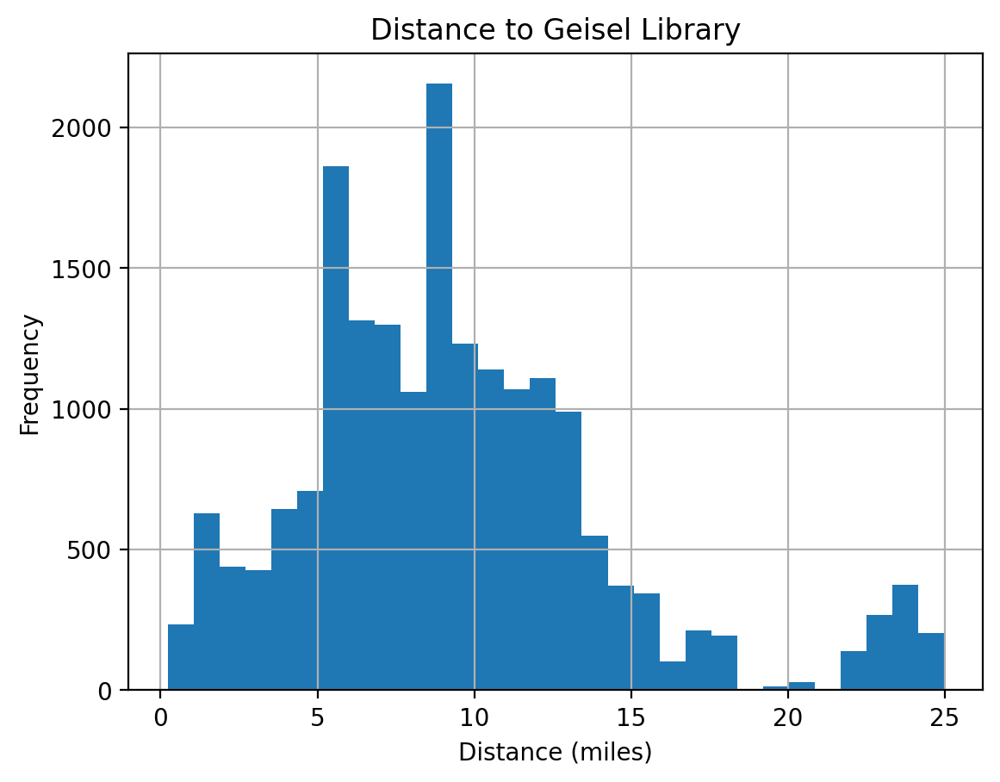

In [22]:
# Plot a histogram for the distance_to_geisel column of collisions_ucsd
collisions_ucsd['distance_to_geisel'].hist(bins=30)
plt.title('Distance to Geisel Library')
plt.xlabel('Distance (miles)')
plt.ylabel('Frequency')


### Analyzing the number of collisions as a function of the week of the UCSD quarter

The plots below show the number of collisions per week as a function of the week (0-10) of the UCSD quarter system. Note that only the Fall quarter has a Week 0. The plot on the left represents the data from all collisions in the dataset, while the plot on the right is only for collisions within 25 miles of UC San Diego. We can see that there is more variability in the plot on the right. This is likely due to the fact that there are fewer collisions in the dataset that are within 25 miles of UC San Diego.

Text(0.5, 1.0, 'Number of Collisions near UCSD per Week, Grouped by Quarter')

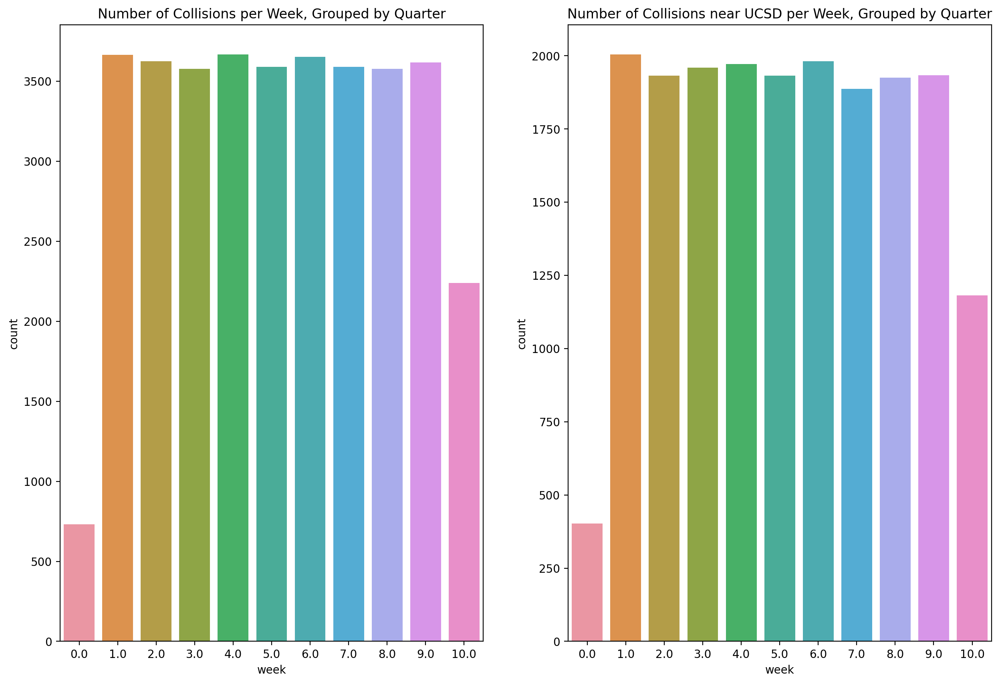

In [23]:
# Plot the number of collisions per week, for each quarter
# Note that the x-axis is the week number, and the y-axis is the number of collisions
# The plot is grouped by quarter
plt.subplots(figsize=(15, 10))
plt.subplot(1, 2, 1)
sns.countplot(x='week', data=collisions)
plt.title("Number of Collisions per Week, Grouped by Quarter")

plt.subplot(1, 2, 2)
sns.countplot(x='week', data=collisions_ucsd)
plt.title("Number of Collisions near UCSD per Week, Grouped by Quarter")

### Non-parametric Hypothesis Testing to investigate the number of collisions in Week 10

Looking at the plots above, we might notice that Week 10 tends to have the least number of collisions. We can investigate this further by performing a non-parametric hypothesis test. We will use the Mann-Whitney U test to compare the number of collisions in Week 10 to the number of collisions in all other weeks.

##### Null Hypothesis: The number of collisions in Week 10 is the same as the number of collisions in all other weeks.
##### Alternative Hypothesis: The number of collisions in Week 10 is lesser than from the number of collisions in all other weeks.

We will use a significance level of 0.05.


In [24]:
# Perform an inference test to check if week 10 has a significantly lower number of collisions than the average week
# Non-parametric test: Mann-Whitney U test
# Null Hypothesis: Week 10 has the same number of collisions as the average week
# Alternative Hypothesis: Week 10 has a significantly lower number of collisions than the average week

from scipy import stats

# Set significance level
alpha = 0.05

# Set up data
# Group data by year, and find the count of collisions in week 10 for every year
week10 = collisions_ucsd.groupby('academic_year')['week'].value_counts().loc[:,10]

# Find the median number of collisions for all other weeks, for every year
other_weeks = collisions_ucsd.groupby('academic_year')['week'].value_counts().loc[:,[1,2,3,4,5,6,7,8,9]]
other_weeks = other_weeks.groupby('academic_year').median().astype(int)

statistic, p_value = stats.mannwhitneyu(week10, other_weeks, alternative='less')
print('Mann-Whitney U test statistic:', statistic)
print('p-value:', p_value)

# Compare p-value to significance level
if p_value < alpha:
    print('Reject null hypothesis: Week 10 has a significantly lower number of collisions than the average week')
else:
    print('Fail to reject null hypothesis: Week 10 has the same number of collisions as the average week')

week10_vs_others = pd.concat([week10, other_weeks], axis=1)
week10_vs_others.columns = ['week10', 'other_weeks']
week10_vs_others


Mann-Whitney U test statistic: 8.0
p-value: 0.005205905205905206
Reject null hypothesis: Week 10 has a significantly lower number of collisions than the average week


,week10,other_weeks
academic_year,,
2015-16,3,2
2016-17,198,328
2017-18,202,305
2018-19,162,313
2019-20,170,259
2020-21,167,257
2021-22,143,253
2022-23,137,237


The results of the hypothesis test indicate that the median number of collisions in Week 10 is significantly different from the median number of collisions in all other weeks. 

It is possible that the collision count could vary based on the quarter of the academic year. Let us investigate this.

### Analyzing the variation in the number of collisions based on the quarter of the academic year

Text(0.5, 1.0, 'Number of Collisions near UCSD per Week, Grouped by Quarter')

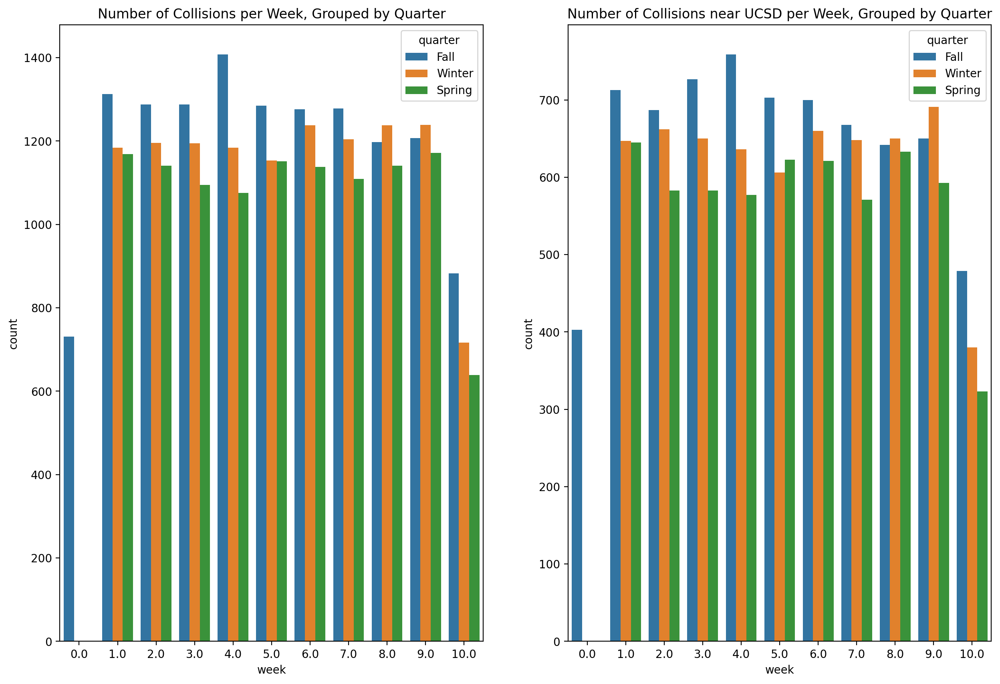

In [25]:
plt.subplots(figsize=(15, 10))
plt.subplot(1, 2, 1)
sns.countplot(x='week', hue='quarter', data=collisions, hue_order=['Fall','Winter','Spring'])
plt.title("Number of Collisions per Week, Grouped by Quarter")

plt.subplot(1, 2, 2)
sns.countplot(x='week', hue='quarter', data=collisions_ucsd, hue_order=['Fall','Winter','Spring'])
plt.title("Number of Collisions near UCSD per Week, Grouped by Quarter")

The plot on the left shows the number of collisions per week for all the collisions data in our dataset. In general, we can see that there is a decrease in the number of collisions on average as you go from Fall to Winter to Spring quarter (with the exception of a few cases) for every week.

The plot on the right, on the other hand, shows the same information but for only collisions near UCSD (within 25 miles of Geisel library). There is again more variation and there isn't a clear trend in the number of collisions per week as you go from Fall to Winter to Spring quarter.

### Variation of the number of collisions versus academic year

Is there a relationship between the number of collisions and the academic year? Firstly, let's plot the number of collisions versus the academic year, for both the total number of collisions and the number of collisions in the UCSD area.

Text(0.5, 0, 'Academic year')

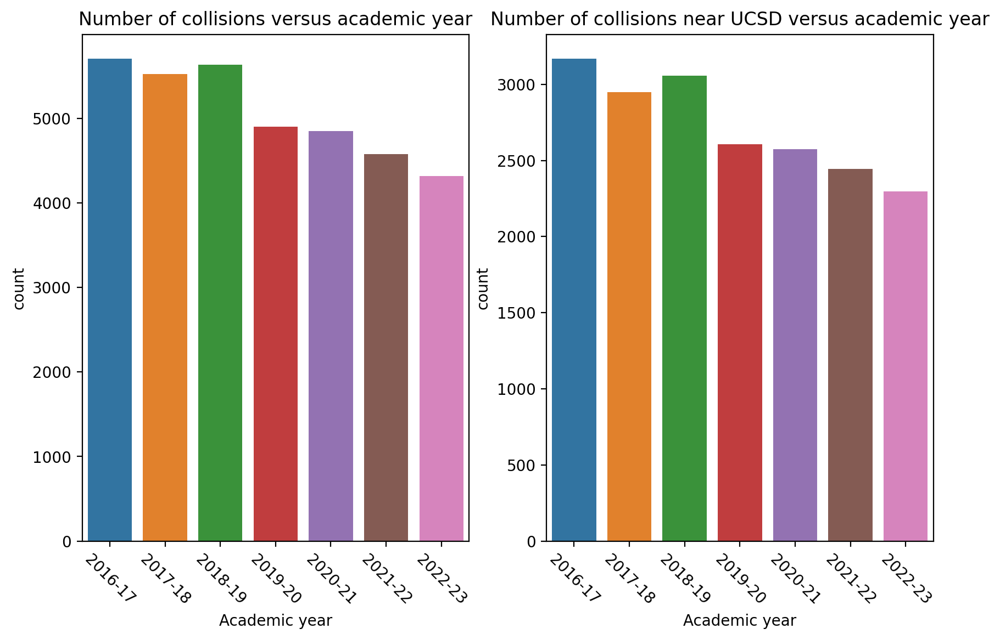

In [26]:
# Plot number of collisions versus academic year
plt.subplots(figsize=(10, 6))
plt.subplot(1, 2, 1)
ax = sns.countplot(x="academic_year", data=collisions[~collisions['academic_year'].isin(['2014-15','2015-16'])],order=['2016-17','2017-18','2018-19','2019-20','2020-21','2021-22','2022-23'])
plt.xticks(rotation=-45)
ax.set_title('Number of collisions versus academic year')
ax.set_xlabel('Academic year')

plt.subplot(1, 2, 2)
ax = sns.countplot(x="academic_year", data=collisions_ucsd[~collisions_ucsd['academic_year'].isin(['2014-15','2015-16'])],order=['2016-17','2017-18','2018-19','2019-20','2020-21','2021-22','2022-23'])
plt.xticks(rotation=-45)
ax.set_title('Number of collisions near UCSD versus academic year')
ax.set_xlabel('Academic year')

Note that the data above excludes the years 2014 and 2015, as the data for those years is incomplete and not comparable to the other years.

We can see that the total number of collisions steadily decreases with time. Let's perform a hypothesis test to see if this is statistically significant.

### Hypothesis Test - Trend in Total Number of Collisions with Time

We will perform a hypothesis test to see if the trend in the total number of collisions with time is statistically significant. We will use a linear regression model to fit a line to the data.

##### Null Hypothesis: There is no linear trend in the total number of collisions with time.
##### Alternative Hypothesis: There is a linear trend in the total number of collisions with time.

We will use a significance level of 0.05.

In [27]:
# Check if there is a linear correlation between the academic year and the number of collisions, considering 2016 onwards
year = sorted(list(set([int(x.split('-')[0]) for x in collisions['academic_year']])))[2:]
number_of_collisions = collisions[~collisions['academic_year'].isin(['2014-15','2015-16'])].groupby('academic_year').size()

from scipy.stats import pearsonr
corr_coeff, p_value = pearsonr(year, number_of_collisions)
significance = 'is' if p_value < 0.05 else 'is not'
print('The correlation coefficient is {:.4f} and the p-value is {:.4f}. This {} significant.'.format(corr_coeff, p_value, significance))

The correlation coefficient is -0.9600 and the p-value is 0.0006. This is significant.


We can see that there is a significant linear trend in the total number of collisions versus academic year. Let's do something similar for the number of collisions in the UCSD area.

### Hypothesis Test - Trend in Total Number of Collisions at UCSD with Time

We will perform a hypothesis test to see if the trend in the number of collisions in the UCSD area with time is statistically significant. We will use a linear regression model to fit a line to the data.

##### Null Hypothesis: There is no linear trend in the total number of collisions with time.
##### Alternative Hypothesis: There is a linear trend in the total number of collisions with time.

We will use a significance level of 0.05.

In [30]:
# Check if there is a linear correlation between the academic year and the number of collisions, considering 2016 onwards
year = sorted(list(set([int(x.split('-')[0]) for x in collisions_ucsd['academic_year']])))[1:]
number_of_collisions = collisions_ucsd[~collisions_ucsd['academic_year'].isin(['2014-15','2015-16'])].groupby('academic_year').size()

from scipy.stats import pearsonr
corr_coeff, p_value = pearsonr(year, number_of_collisions)
significance = 'is' if p_value < 0.05 else 'is not'
print('The correlation coefficient is {:.4f} and the p-value is {:.4f}. This {} significant.'.format(corr_coeff, p_value, significance))

The correlation coefficient is -0.9582 and the p-value is 0.0007. This is significant.


The correlation is significant according to the test.


### Analyzing the number of collisions as a function of the time of day

This part analyzes the number of collisions occurring at different times of the day. The data is grouped by the hour of the day and the number of collisions is counted for each hour. The results are plotted in a bar chart. This is done for the entire dataset and for the subset of the data near UCSD.

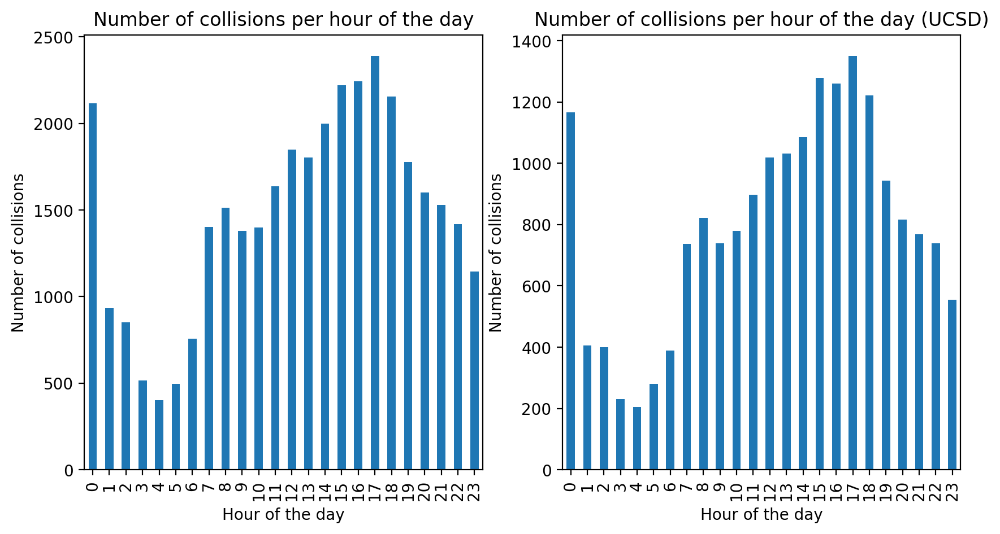

In [31]:
# Plot the number of collisions versus time of the day
# the date_time column contains this data as a datetime object
# we can extract the hour of the day from this object using the .dt.hour attribute
# we can then use the .value_counts() method to count the number of collisions for each hour

plt.subplots(figsize=(10, 5))
plt.subplot(1, 2, 1)
collisions.date_time.dt.hour.value_counts().sort_index().plot(kind='bar')
plt.xlabel('Hour of the day')
plt.ylabel('Number of collisions')
plt.title('Number of collisions per hour of the day')

plt.subplot(1, 2, 2)
collisions_ucsd.date_time.dt.hour.value_counts().sort_index().plot(kind='bar')
plt.xlabel('Hour of the day')
plt.ylabel('Number of collisions')
plt.title('Number of collisions per hour of the day (UCSD)')

plt.show()


The distributions look very similar, but we can use a statistical test to analyze if the data come from the same distribution.

In [32]:
# Statistical test to check if data come from the same distribution
# Use Kruskal-Wallis H-test for independent samples

from scipy.stats import kruskal

# H0: the distributions of all groups are equal
# H1: the distributions of one or more groups are not equal
alpha = 0.05

# Normalized data
data_all = collisions.date_time.dt.hour.value_counts().sort_index()
data_all = data_all / data_all.sum()
data_ucsd = collisions_ucsd.date_time.dt.hour.value_counts().sort_index()
data_ucsd = data_ucsd / data_ucsd.sum()

stat, p = kruskal(data_all, data_ucsd)
print('Statistics=%.3f, p=%.5f' % (stat, p))
if p > alpha:
    print('Same distribution (fail to reject H0)')
else:
    print('Different distribution (reject H0)')

Statistics=0.004, p=0.95068
Same distribution (fail to reject H0)


Thus we have evidence that the distribution of collisions over hours from collisions near UCSD follows a similar distribution as that for all collisions data.

### Plotting the number of collisions per week for each academic year

This section is used to visualize the distribution of collisions every week, for each year.

<Figure size 640x480 with 0 Axes>

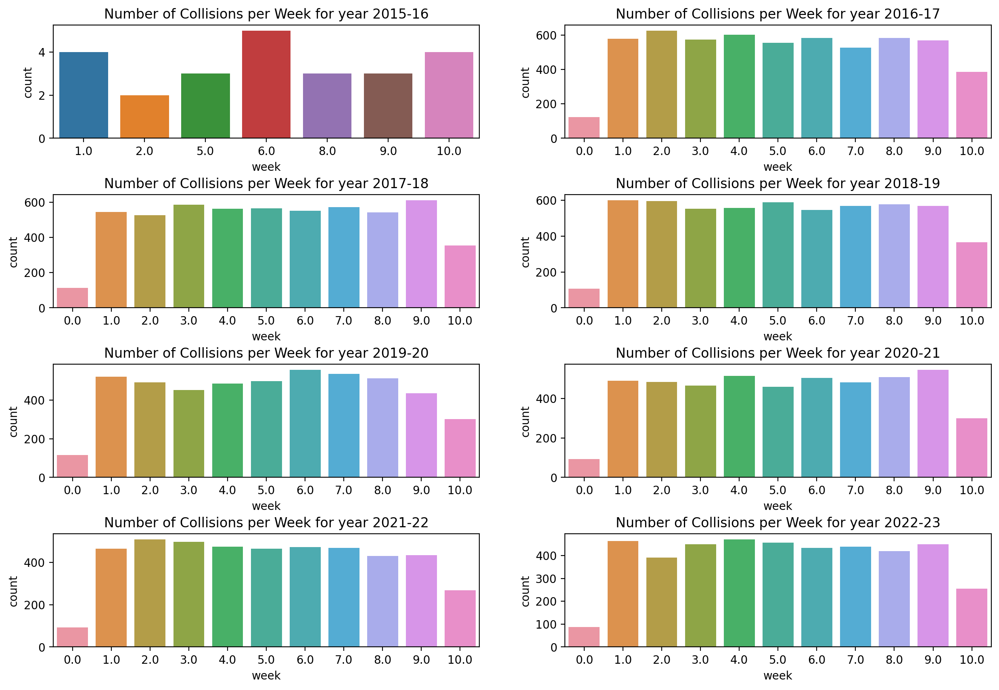

In [33]:
plt.tight_layout()
academic_years = ['2015-16', '2016-17', '2017-18', '2018-19', '2019-20', '2020-21', '2021-22', '2022-23']
plt.subplots(figsize=(15, 10))
plt.subplots_adjust(hspace=0.5)
for year in academic_years:
    plt.subplot(4, 2, academic_years.index(year)+1)
    sns.countplot(x='week', data=collisions[collisions['academic_year'].isin([year])])
    plt.title(f"Number of Collisions per Week for year {year}")

Note that the year 2015-16 is an outlier because the collisions dataset does not contain sufficient data for that year. The other years, however, follow a similar distribution.

### Visualizing Location Data

Now, let's visualize the location data! We'll use the `folium` library to create a map of the world and then add markers to it to show the locations of the collisions in our dataset.

In [34]:
# Find the range of latitude and longitude for collisions_ucsd
print("Latitude range: ", min(collisions_ucsd['latitude']), max(collisions_ucsd['latitude']))
print("Longitude range: ", min(collisions_ucsd['longitude']), max(collisions_ucsd['longitude']))

Latitude range:  32.5436231 33.2080516
Longitude range:  -117.3660839 -116.9032373


In [35]:
map_center = [collisions_ucsd['latitude'].sum() / len(collisions_ucsd['latitude']), collisions_ucsd['longitude'].sum() / len(collisions_ucsd['longitude'])]
my_map = folium.Map(location=map_center, zoom_start=12)

for index, row in collisions_ucsd.iterrows():
    folium.Marker([row['latitude'], row['longitude']], popup=row['address_primary']).add_to(my_map)

# Make a special red marker for the UCSD campus
folium.Marker([GEISEL_LIBRARY_LATITUDE, GEISEL_LIBRARY_LONGITUDE], popup='UCSD', icon=folium.Icon(color='red')).add_to(my_map)

# Display the map
my_map
